# Bitcoin Stock Prediction Using Deep Learning and Sentiment Analysis
---

### This notebook analyzes Bitcoin historical values and how we can predict next values for Bitcoin closing prices

## Introduction

### What is a crypto currency  and why Bitcoin?

According to wikipedia, a cryptocurrency is a digital asset designed to work as a medium of exchange using "cryptography" to secure the transactions and to control the creation of additional units of the currency by "mining". 

While the best-known example of a cryptocurrency is Bitcoin, there are more than 100 other tradable cryptocurrencies, called altcoins (meaning alternative to Bitcoin), competing each other and with Bitcoin. 

The motive behind this competition is that there are a number of design flaws in Bitcoin, and people are trying to invent new coins to overcome these defects hoping their inventions will eventually replace Bitcoin. 

To June 2021, the total market capital of all cryptocurrencies is 102 billion in USD, 41 of which is of Bitcoin. Therefore, regardless of its design faults, Bitcoin is still the dominant cryptocurrency in markets. As a result, many altcoins cannot be bought with fiat currencies, but only be traded against Bitcoin. 

Hence, I chose Bitcoin as my commodity in order to make wiser future investments for my cryptocurrency portfolio.

The ubiquity of Internet access has triggered the emergence of currencies distinct from those used in the prevalent monetary system. The advent of cryptocurrencies based on a unique method called “mining” has brought about significant changes in the online economic activities of users.

Cryptocurrencies are primarily characterized by fluctuations in their price and number of transactions [\[1\]](#ref1)[\[2\]](#ref2). Although Bitcoin was first introduced in 2008 [\[2\]](#ref2)[\[3\]](#ref3), it had witnessed no significant fluctuation in its price and number of transactions until the end of 2013 [\[2\]](#ref2), when it began to garner worldwide attention, and witnessed a significant rise and fluctuation in its price and number of transactions. Such unstable fluctuations have served as an opportunity for speculation for some users while hindering most others from using cryptocurrencies [\[1\]](#ref1)[\[4\]](#ref4)[\[5\]](#ref5)

## Methods

My research will follow a comparative approach. My first framework is a Recurrent Neural Network trained on 3 popular stock market indicators and past prices as key data points to find an optimal technique for cryptocurrency stock market prediction. 

My second framework is a sequential model, trained on the sentiment of the public company news history and past prices as key data points, consisting of a single Long Short-Term Memory (LSTM) layer to generate a prediction vector for the whole input sequence and 1 Linear Dense Layer to aggregate the data into a single value.

Comparison will be made on the basis of their performance. Both techniques have some advantages and disadvantages. My research will analyze advantages and limitations of these techniques to find which technique is comparatively better for specifically Bitcoin stock market prediction. 

## Background

In a traditional recurrent neural network, during the gradient back-propagation phase, the gradient signal can end up being multiplied a large number of times (as many as the number of time steps) by the weight matrix associated with the connections between the neurons of the recurrent hidden layer. This means that, the magnitude of weights in the transition matrix can have a strong impact on the learning process.

If the weights in this matrix are small (or, more formally, if the leading eigenvalue of the weight matrix is smaller than 1.0), it can lead to a situation called vanishing gradients where the gradient signal gets so small that learning either becomes very slow or stops working altogether. It can also exacerbate the task of learning long-term dependencies in the data. Conversely, if the weights in this matrix are large (or, again, more formally, if the leading eigenvalue of the weight matrix is larger than 1.0), it can lead to a situation where the gradient signal is so large that it can cause learning to diverge. This is often referred to as exploding gradients.

These issues are the main motivation behind the LSTM model which introduces a new structure called a memory cell. A memory cell is composed of four main elements: an input gate, a neuron with a self-recurrent connection (a connection to itself), a forget gate and an output gate. The self-recurrent connection has a weight of 1.0 and ensures that, barring any outside interference, the state of a memory cell can remain constant from one time step to another.



The gates serve to modulate the interactions between the memory cell itself and its environment. The input gate can allow incoming signal to alter the state of the memory cell or block it. On the other hand, the output gate can allow the state of the memory cell to have an effect on other neurons or prevent it. Finally, the forget gate can modulate the memory cell’s self-recurrent connection, allowing the cell to remember or forget its previous state, as needed.

I believe the biggest difference between the NLP and financial analysis is that language has some guarantee of structure, it’s just that the rules of the structure are vague. Markets, on the other hand, don’t come with a promise of a learnable structure, that such a structure exists is the assumption that this project would prove or disprove (rather it might prove or disprove if I can find that structure).

Assuming that a structure exists; the idea of summarizing the current state of the market in the same way we encode the semantics of a paragraph seems plausible to me.

## A Data-Driven Approach To Cryptocurrency Speculation

*How do Bitcoin markets behave? What are the causes of the sudden spikes and dips in cryptocurrency values? How can we predict what will happen next?*

Research on the attributes of cryptocurrencies has made steady progress but has a long way to go. Most researchers analyze user sentiments related to cryptocurrencies on social media, e.g., Twitter, or quantified Web search queries on search engines, such as Google, as well as fluctuations in price and trade volume to determine any relation [\[6–10\]](#ref6to10). Past studies have been limited to Bitcoin because the large amount of data that it provides eliminates the need to build a model to predict fluctuations in the price and number of transactions of diverse cryptocurrencies.

Articles on cryptocurrencies, such as Bitcoin, are rife with speculation these days, with hundreds of self-proclaimed experts advocating for the trends that they expect to emerge. What is lacking from many of these analyses is a strong data analysis foundation to backup the claims. 

So, I felt that analysis of the top headlines on the first page of Google News results for the term **Bitcoin** to predict its closing price for the next day seemed like the most unbiased approach to resolving the biased opinions strewn around the web. I also felt exclusion of the **"Price"** suffix was justified by the fact that its inclusion led to Google News returning those biased news articles as opposed to just news revolving around Bitcoin that I feel is more relevant for my unbiased prediction of closing prices.

This approach also resonates with my personal approach to track the closing prices of the cryptocurrencies I have invested in. I always find myself skimming through the most important headlines on the first page of the Google News results. Extrapolation of my research method to apply to a sample of the population representing crytocurrency investors also seems fair. Don't agree? [This article](https://www.bloomberg.com/news/articles/2017-11-07/bitcoin-rally-is-eroding-gold-s-appeal-top-online-vaulter-says) on Bloomberg Markets does! 

In a nutshell, the article suggests that, according to Google Trends, global searches for “buy bitcoin” have overtaken “buy gold” after previously exceeding searches for how to purchase silver.

**Note** - Numbers represent search interest relative to the highest point on the chart for the given region and time. A value of 100 is the peak popularity for the term. A value of 50 means that the term is half as popular. Likewise a score of 0 means the term was less than 1% as popular as the peak.

![alt text](Buy Bitcoin Google Trends.png "Buy_Bitcoin")

For the rest of the skeptics, I decided to explore Google Trends myself to evaluate the legitimacy of my claim. So the global search for **bitcoin** for the time period **starting from January 3, 2009**; when the first Bitcoin transaction record, or genesis block, kicked off the Bitcoin blockchain and included a reference to a pertinent newspaper headline of that day: 

*The Times 03/Jan/2009 Chancellor on brink of second bailout for banks.*

Sources:
* https://en.bitcoin.it/wiki/Genesis_block
* https://www.mail-archive.com/cryptography@metzdowd.com/msg10142.html

looks like this:

![alt text](Bitcoin Google Trends.png "Buy_Bitcoin")

## Input Data

### Initial Features Set

My initial features set include the Adjusted Open, Adjusted High, Adjusted Low, Adjusted Close, Adjusted Volume for BTC, Adjusted Volume for Currency and Weighted Price for Bitcoin retrieved using [Quandl's free Bitcoin API](https://blog.quandl.com/api-for-bitcoin-data) for dates ranging from January 7, 2021 to December 12, 2021.

I used pickle to serialize and save the downloaded data as a file, which will prevent my script from re-downloading the same data each time I run the script.

In [30]:
# Define Quandl Helper Function to download and cache bitcoin dataset from Quandl
import json
import numpy as np
import pandas as pd
import pickle
import quandl
from datetime import datetime
import plotly.offline as py
import plotly.graph_objs as go
import plotly.figure_factory as ff
py.init_notebook_mode(connected=True)

with open('api_key.json') as f:
    api = json.load(f)
quandl.ApiConfig.api_key = api["api_key"]

def get_quandl_data(quandl_id):
    #Download and cache Quandl dataseries
    cache_path = '{}.pkl'.format(quandl_id).replace('/','-')
    try:
        f = open(cache_path, 'rb')
        df = pickle.load(f)   
        print('Loaded {} from cache'.format(quandl_id))
    except (OSError, IOError) as e:
        print('Downloading {} from Quandl'.format(quandl_id))
        df = quandl.get(quandl_id, returns="pandas", start_date="2014-01-07", end_date="2017-12-12")
        df.to_pickle(cache_path)
        print('Cached {} at {}'.format(quandl_id, cache_path))
    return df

# Pull Kraken BTC exchange historical pricing data
btc_usd_price_kraken = get_quandl_data('BCHARTS/KRAKENUSD')

btc_usd_price_kraken.head()

Loaded BCHARTS/KRAKENUSD from cache


,Open,High,Low,Close,Volume (BTC),Volume (Currency),Weighted Price
Date,,,,,,,
2014-01-07,874.67040,892.06753,810.00000,810.00000,15.622378,13151.472844,841.835522
2014-01-08,810.00000,899.84281,788.00000,824.98287,19.182756,16097.329584,839.156269
2014-01-09,825.56345,870.00000,807.42084,841.86934,8.158335,6784.249982,831.572913
2014-01-10,839.99000,857.34056,817.00000,857.33056,8.024510,6780.220188,844.938794
2014-01-11,858.20000,918.05471,857.16554,899.84105,18.748285,16698.566929,890.671709


In [31]:
# Chart the BTC close pricing data
btc_trace = go.Scatter(x=btc_usd_price_kraken.index, y=btc_usd_price_kraken['Close'])
py.iplot([btc_trace])

### Observations

There are a few notable down-spikes, particularly in late 2014 and early 2016. These spikes are specific to the Kraken dataset, and I obviously don't want them to be reflected in my overall pricing analysis.

The nature of Bitcoin exchanges is that the pricing is determined by supply and demand, hence no single exchange contains a true "master price" of Bitcoin. To solve this issue, along with that of down-spikes, I pulled data from three more major Bitcoin changes to calculate an aggregate Bitcoin price index.

In [32]:
# Pull pricing data for 3 more BTC exchanges
exchanges = ['COINBASE','BITSTAMP','ITBIT']

exchange_data = {}

exchange_data['KRAKEN'] = btc_usd_price_kraken

for exchange in exchanges:
    exchange_code = 'BCHARTS/{}USD'.format(exchange)
    btc_exchange_df = get_quandl_data(exchange_code)
    exchange_data[exchange] = btc_exchange_df

Loaded BCHARTS/COINBASEUSD from cache
Loaded BCHARTS/BITSTAMPUSD from cache
Loaded BCHARTS/ITBITUSD from cache


In [33]:
# Merge All Of The Pricing Data Into A Single Dataframe
def merge_dfs_on_column(dataframes, labels, col):
    # Merge a single column of each dataframe into a new combined dataframe
    series_dict = {}
    for index in range(len(dataframes)):
        series_dict[labels[index]] = dataframes[index][col]
        
    return pd.DataFrame(series_dict)

# Merge the BTC price dataseries' into a single dataframe on their "Close Price" column
btc_usd_datasets_close = merge_dfs_on_column(list(exchange_data.values()), list(exchange_data.keys()), 'Close')
btc_usd_datasets_open = merge_dfs_on_column(list(exchange_data.values()), list(exchange_data.keys()), 'Open')
btc_usd_datasets_high = merge_dfs_on_column(list(exchange_data.values()), list(exchange_data.keys()), 'High')
btc_usd_datasets_low = merge_dfs_on_column(list(exchange_data.values()), list(exchange_data.keys()), 'Low')

btc_usd_datasets_close.tail()

,KRAKEN,COINBASE,BITSTAMP,ITBIT
Date,,,,
2017-12-08,15921.9,16367.03,15800.00,16158.92
2017-12-09,14682.9,15309.98,14607.49,15062.92
2017-12-10,14850.3,15290.01,14691.00,15301.96
2017-12-11,16578.0,16885.76,16470.00,16907.28
2017-12-12,16889.3,17730.12,16650.01,17333.51


In [40]:
# Visualize The Pricing Datasets

# Helper function to provide a single-line command to compare each column in the dataframe
def df_scatter(df, title, seperate_y_axis=False, y_axis_label='', scale='linear', initial_hide=False):
    #Generate a scatter plot of the entire dataframe
    label_arr = list(df)
    series_arr = list(map(lambda col: df[col], label_arr))
    
    layout = go.Layout(
        title=title,
        legend=dict(orientation="h"),
        xaxis=dict(type='date'),
        yaxis=dict(
            title=y_axis_label,
            showticklabels= not seperate_y_axis,
            type=scale
        )
    )
    
    y_axis_config = dict(
        overlaying='y',
        showticklabels=False,
        type=scale )
    
    visibility = True
    if initial_hide:
        visibility = 'legendonly'
        
    # Form Trace For Each Series
    trace_arr = []
    for index, series in enumerate(series_arr):
        trace = go.Scatter(
            x=series.index, 
            y=series, 
            name=label_arr[index],
            visible=visibility
        )
        
        # Add seperate axis for the series
        if seperate_y_axis:
            trace['yaxis'] = 'y{}'.format(index + 1)
            layout['yaxis{}'.format(index + 1)] = y_axis_config    
        trace_arr.append(trace)

    fig = go.Figure(data=trace_arr, layout=layout)
    py.iplot(fig)
    
# Plot all of the BTC exchange closing prices
df_scatter(btc_usd_datasets_close, 'Bitcoin Closing Price (USD) By Exchange')

### Observations

Although the four series follow roughly the same path, there are various irregularities in each that should be eliminated. Since the price of Bitcoin has never been equal to zero in the timeframe that I was examining it makes sense to remove all of the zero values from the combined dataframe.

In [41]:
# Remove "0" values
btc_usd_datasets_close.replace(0, np.nan, inplace=True)
btc_usd_datasets_open.replace(0, np.nan, inplace=True)
btc_usd_datasets_high.replace(0, np.nan, inplace=True)
btc_usd_datasets_low.replace(0, np.nan, inplace=True)

# Plot the cleaned dataframe
df_scatter(btc_usd_datasets_close, 'Bitcoin Closing Price (USD) By Exchange')

In [42]:
# Calculate the average BTC closing price as a new column
btc_usd_datasets_close['avg_btc_close_price_usd'] = btc_usd_datasets_close.mean(axis=1)
btc_usd_datasets_open['avg_btc_open_price_usd'] = btc_usd_datasets_open.mean(axis=1)
btc_usd_datasets_high['avg_btc_high_price_usd'] = btc_usd_datasets_high.mean(axis=1)
btc_usd_datasets_low['avg_btc_low_price_usd'] = btc_usd_datasets_low.mean(axis=1)

# Plot the average BTC closing price
btc_trace = go.Scatter(x=btc_usd_datasets_close.index, y=btc_usd_datasets_close['avg_btc_close_price_usd'])
py.iplot([btc_trace])

In [43]:
btc_usd_datasets_close_final = btc_usd_datasets_close['avg_btc_close_price_usd'].copy()
btc_usd_datasets_open_final = btc_usd_datasets_open['avg_btc_open_price_usd'].copy()
btc_usd_datasets_high_final = btc_usd_datasets_high['avg_btc_high_price_usd'].copy()
btc_usd_datasets_low_final = btc_usd_datasets_low['avg_btc_low_price_usd'].copy()

btc_usd_datasets_close_final = btc_usd_datasets_close_final.reset_index()
btc_usd_datasets_open_final = btc_usd_datasets_open_final.reset_index()
btc_usd_datasets_high_final = btc_usd_datasets_high_final.reset_index()
btc_usd_datasets_low_final = btc_usd_datasets_low_final.reset_index()

btc_usd_datasets_open_final.columns = ['Date','Average Open Price (USD)']
btc_usd_datasets_high_final.columns = ['Date','Average High Price (USD)']
btc_usd_datasets_low_final.columns = ['Date','Average Low Price (USD)']
btc_usd_datasets_close_final.columns = ['Date','Average Close Price (USD)']

btc_usd_datasets_close_final.head()

,Date,Average Close Price (USD)
0,2014-01-07,795.333333
1,2014-01-08,825.656790
2,2014-01-09,838.876447
3,2014-01-10,848.229587
4,2014-01-11,897.770750


In [44]:
btc_usd_datasets_final_1 = pd.merge(btc_usd_datasets_open_final, btc_usd_datasets_high_final, on='Date')
btc_usd_datasets_final_2 = pd.merge(btc_usd_datasets_low_final, btc_usd_datasets_close_final, on='Date')                                  
btc_usd_datasets_final = pd.merge(btc_usd_datasets_final_1, btc_usd_datasets_final_2, on='Date') 
btc_usd_datasets_final.to_csv('BTC_USD.csv', index=False)
btc_usd_datasets_final.head()                                   

,Date,Average Open Price (USD),Average High Price (USD),Average Low Price (USD),Average Close Price (USD)
0,2014-01-07,906.386867,921.252577,795.333333,795.333333
1,2014-01-08,792.000000,862.560037,774.666667,825.656790
2,2014-01-09,827.741783,856.000000,794.042547,838.876447
3,2014-01-10,832.822867,851.162920,816.462867,848.229587
4,2014-01-11,869.610000,909.429470,867.225180,897.770750


### Secondary Features Set

This features set builds out my dataframe from a csv file named [**BTC_USD.csv**](BTC_USD.csv) that I generated by extending the protocol governing the definition of my initial features set.

## The model in theory

I am going to use 4 features: The **close price** and three extra technical indicators.
- MACD (Trend Indicator)
- Stochastics (Momentum Indicator)
- Average True Range (Volume Indicator)

## Functions

### Trend Indicator

[What is a trend?](https://www.investopedia.com/university/technical/techanalysis3.asp)

**Exponential Moving Average:** Is a type of infinite impulse response filter that applies weighting factors which decrease exponentially. The weighting for each older datum decreases exponentially, never reaching zero. It is similar to a simple moving average, except that more weight is given to the latest data. It's also known as the exponentially weighted moving average. This type of moving average reacts faster to recent price changes than a simple moving average. The 12- and 26-day EMAs are the most popular short-term averages and they are used to create indicators like the moving average convergence divergence (MACD) and the percentage price oscillator (PPO). 



**MACD:**  The Moving Average Convergence/Divergence oscillator (MACD) is one of the simplest and most effective momentum indicators available. The MACD turns two trend-following indicators, moving averages, into a momentum oscillator by subtracting the longer moving average from the shorter moving average.


### Momentum Indicator

[What is momentum?](https://www.investopedia.com/terms/m/momentum.asp?ad=dirN&qo=investopediaSiteSearch&qsrc=0&o=40186)

**Stochastics oscillator:** The Stochastic Oscillator is a momentum indicator that shows the location of the close relative to the high-low range over a set number of periods. It measures whether the closing price of a security is closer to the high or the low. It is based on the assumption that when a market is trending upward, the closing price will be closer to the highest price, and, when it is trending downward, the closing price will be closer to the lowest price.


### Volume Indicator

[What is volume?](https://www.investopedia.com/terms/v/volume.asp)

**Average True Range:** Is an indicator to measure the volalitility (NOT price direction). The true range indicator is the largest of:
- Method A: Current High less the current Low
- Method B: Current High less the previous Close (absolute value)
- Method C: Current Low less the previous Close (absolute value)

The average true range is a moving average, generally 14 days, of the true ranges. Basically a stock experiencing a high level of volatility has a higher ATR, and a low volatility stock has a lower ATR. 


In [45]:
def MACD(df,period1,period2,periodSignal):
    EMA1 = pd.DataFrame.ewm(df,span=period1).mean()
    EMA2 = pd.DataFrame.ewm(df,span=period2).mean()
    MACD = EMA1-EMA2
    
    Signal = pd.DataFrame.ewm(MACD,periodSignal).mean()
    
    Histogram = MACD-Signal
    
    return Histogram

def stochastics_oscillator(df,period):
    l, h = pd.DataFrame.rolling(df, period).min(), pd.DataFrame.rolling(df, period).max()
    k = 100 * (df - l) / (h - l)
    return k

def ATR(df,period):
    '''
    Method A: Current High less the current Low
    '''
    df['H-L'] = abs(df['Average High Price (USD)']-df['Average Low Price (USD)'])
    '''
    Method B: Current High less the previous Close (absolute value)
    '''
    df['H-PC'] = abs(df['Average High Price (USD)']-df['Average Close Price (USD)'].shift(1))
    '''
    Method C: Current Low less the previous Close (absolute value)
    '''
    df['L-PC'] = abs(df['Average Low Price (USD)']-df['Average Close Price (USD)'].shift(1))
    TR = df[['H-L','H-PC','L-PC']].max(axis=1)
    return TR.to_frame()

### Read Data

In [46]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
pd.options.mode.chained_assignment = None

df = pd.read_csv('BTC_USD.csv',usecols=[1,2,3,4])

dfPrices = pd.read_csv('BTC_USD.csv',usecols=[4])

In [47]:
dfPrices.head(2)

,Average Close Price (USD)
0,795.333333
1,825.656790


## Plot Data

### Plotting Price

In [50]:
price = dfPrices.iloc[len(dfPrices.index)-60:len(dfPrices.index)].values.ravel()

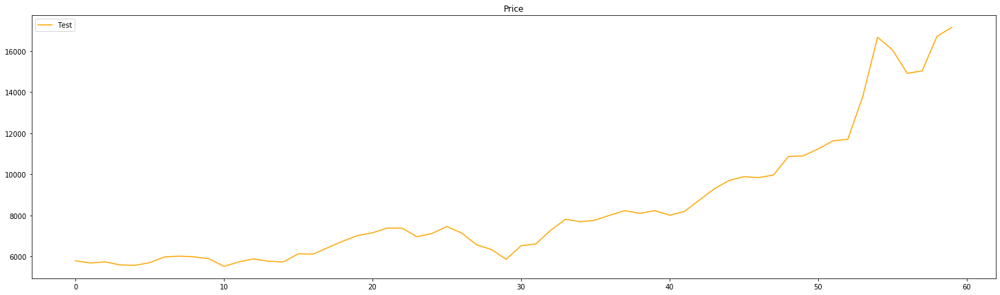

In [52]:
prices = dfPrices.iloc[len(dfPrices.index)-60:len(dfPrices.index)].values.ravel()
plt.figure(figsize=(25,7))
plt.plot(prices,label='Test',color='orange')
plt.title('Price')
plt.legend(loc='upper left')
plt.show()

### Plotting MACD

In [53]:
macd = MACD(dfPrices.iloc[len(dfPrices.index)-60:len(dfPrices.index)],12,26,9)

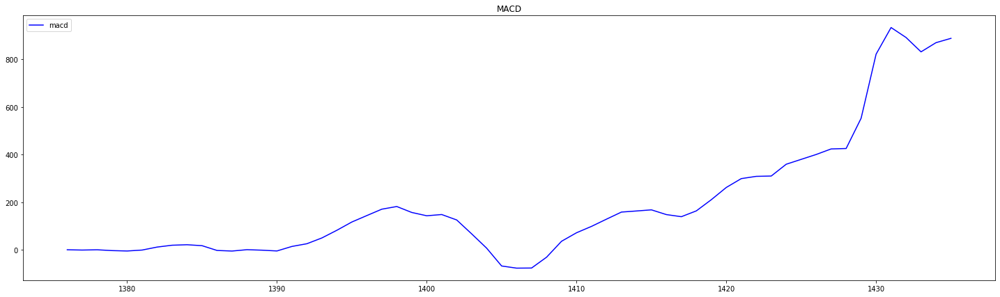

In [54]:
plt.figure(figsize=(25,7))
plt.plot(macd,label='macd',color='blue')
plt.title('MACD')
plt.legend(loc='upper left')
plt.show()

### Plotting Stochastics Oscillator

In [55]:
stochastics = stochastics_oscillator(dfPrices.iloc[len(dfPrices.index)-60:len(dfPrices.index)],14)

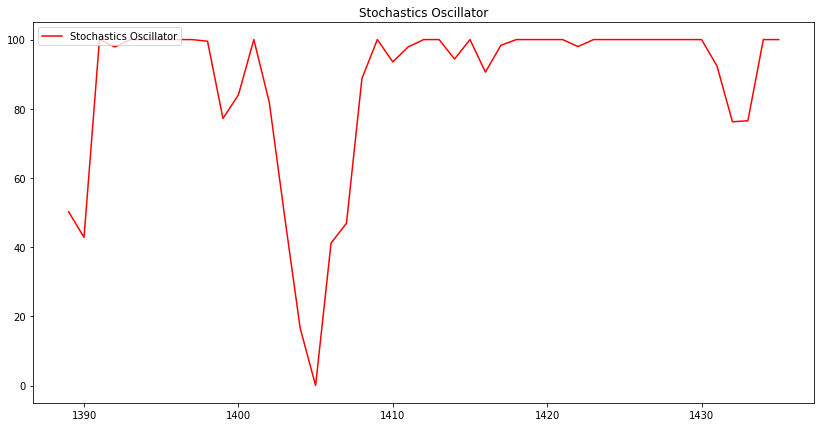

In [56]:
plt.figure(figsize=(14,7))
#First 100 points due to extreme density
plt.plot(stochastics[0:100],label='Stochastics Oscillator',color='red')
plt.title('Stochastics Oscillator')
plt.legend(loc='upper left')
plt.show()

### Plotting Average True Range

In [57]:
atr = ATR(df.iloc[len(df.index)-60:len(df.index)],14)

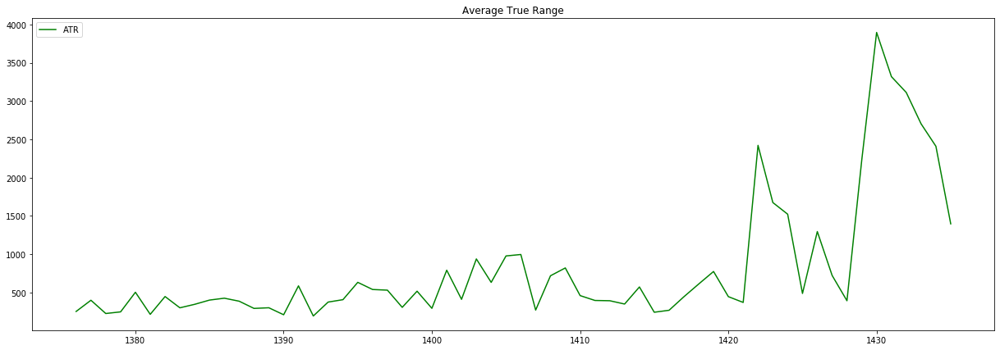

In [58]:
plt.figure(figsize=(21,7))
#First 100 points due to extreme density
plt.plot(atr[0:100],label='ATR',color='green')
plt.title('Average True Range')
plt.legend(loc='upper left')
plt.show()

## Create Final Dataframe and Save Data

In [59]:
dfPriceShift = dfPrices.shift(-1)
dfPriceShift.rename(columns={'Average Close Price (USD)':'Average Close Price Target (USD)'}, inplace=True)
dfPriceShift.head(2)

,Average Close Price Target (USD)
0,825.656790
1,838.876447


In [60]:
macd = MACD(dfPrices,12,26,9)
macd.rename(columns={'Average Close Price (USD)':'MACD'}, inplace=True)

In [61]:
stochastics = stochastics_oscillator(dfPrices,14)
stochastics.rename(columns={'Average Close Price (USD)':'Stochastics'}, inplace=True)

In [62]:
atr = ATR(df,14)
atr.rename(columns={0:'ATR'}, inplace=True)

In [63]:
final_data = pd.concat([dfPrices,dfPriceShift,macd,stochastics,atr], axis=1)
# Delete the entries with missing values (where the stochastics couldn't be computed yet) 
final_data = final_data.dropna()

In [64]:
final_data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1422 entries, 13 to 1434
Data columns (total 5 columns):
 #   Column                            Non-Null Count  Dtype  
---  ------                            --------------  -----  
 0   Average Close Price (USD)         1422 non-null   float64
 1   Average Close Price Target (USD)  1422 non-null   float64
 2   MACD                              1422 non-null   float64
 3   Stochastics                       1422 non-null   float64
 4   ATR                               1422 non-null   float64
dtypes: float64(5)
memory usage: 66.7 KB


In [65]:
final_data

,Average Close Price (USD),Average Close Price Target (USD),MACD,Stochastics,ATR
13,831.045463,821.300000,-1.712121,34.862388,30.227933
14,821.300000,819.029997,-1.690852,24.314425,25.633297
15,819.029997,819.699457,-1.725941,22.067729,12.507147
16,819.699457,788.295283,-1.639052,22.730315,15.930397
17,788.295283,809.606667,-3.255442,0.000000,45.300023
...,...,...,...,...,...
1430,16667.930000,16061.962500,795.651645,100.000000,3896.180000
1431,16061.962500,14915.822500,910.456660,92.349675,3318.607500
1432,14915.822500,15033.317500,869.431672,76.235360,3111.735000
1433,15033.317500,16710.260000,809.567318,76.530998,2702.245000


In [66]:
final_data.to_csv('BTC_USD_TechnicalIndicators.csv',index=False)

# First Framework - Recurrent Neural Network trained on Initial Features (Historical Bitcoin Prices) and Secondary Features ( Fiat Currency Stock Market Technical Indicators)

In [74]:
import pandas as pd 
import numpy as np
import matplotlib.pyplot as plt
import tensorflow as tf
%matplotlib inline

## Read the data

In [75]:
df = pd.read_csv('BTC_USD_TechnicalIndicators.csv')
df.head(2)

,Average Close Price (USD),Average Close Price Target (USD),MACD,Stochastics,ATR
0,831.045463,821.300000,-1.712121,34.862388,30.227933
1,821.300000,819.029997,-1.690852,24.314425,25.633297


## Normalize the data

In [76]:
dfNorm = (df - df.mean()) / (df.max() - df.min())
dfNorm.head()

,Average Close Price (USD),Average Close Price Target (USD),MACD,Stochastics,ATR
0,-0.018616,-0.019383,-0.008789,-0.220788,-0.012736
1,-0.019205,-0.019517,-0.008770,-0.326268,-0.013916
2,-0.019342,-0.019477,-0.008801,-0.348734,-0.017287
3,-0.019302,-0.021327,-0.008725,-0.342109,-0.016408
4,-0.021201,-0.020072,-0.010136,-0.569412,-0.008866


## Defining the Hyperparameters

In [77]:
num_epochs = 500
total_series_length = len(df.index)
# Sequence Size
truncated_backprop_length = 3
# Number of neurons
state_size = 12 
num_classes = 1
num_features = 4
batch_size = 1
num_batches = total_series_length//batch_size//truncated_backprop_length
min_test_size = 100

print('The total length of the series is: {}'.format(total_series_length))
print('The current configuration gives us {} batches of {} observation each, where each one is looking {} steps in the past'.format(num_batches,batch_size,truncated_backprop_length))

The total length of the series is: 1422
The current configuration gives us 474 batches of 1 observation each, where each one is looking 3 steps in the past


## Splitting the data into Training and Testing sets

In [78]:
dfTrain = dfNorm[df.index < num_batches*batch_size*truncated_backprop_length]


for i in range(min_test_size,len(dfNorm.index)):
    
    if(i % truncated_backprop_length*batch_size == 0):
        test_first_idx = len(dfNorm.index)-i
        break

dfTest =  dfNorm[df.index >= test_first_idx]

In [79]:
dfTrain.head()

,Average Close Price (USD),Average Close Price Target (USD),MACD,Stochastics,ATR
0,-0.018616,-0.019383,-0.008789,-0.220788,-0.012736
1,-0.019205,-0.019517,-0.008770,-0.326268,-0.013916
2,-0.019342,-0.019477,-0.008801,-0.348734,-0.017287
3,-0.019302,-0.021327,-0.008725,-0.342109,-0.016408
4,-0.021201,-0.020072,-0.010136,-0.569412,-0.008866


In [80]:
dfTest.head()

,Average Close Price (USD),Average Close Price Target (USD),MACD,Stochastics,ATR
1320,0.229252,0.204506,0.021086,0.430588,0.041945
1321,0.210649,0.204507,0.007767,0.100816,0.101170
1322,0.210649,0.188199,-0.005007,0.100827,0.058924
1323,0.193907,0.193255,-0.034349,-0.254283,0.103168
1324,0.199098,0.204309,-0.051670,-0.199283,0.087348


In [84]:
xTrain = dfTrain[['Average Close Price (USD)','MACD','Stochastics','ATR']].values
yTrain = dfTrain['Average Close Price Target (USD)'].values

In [85]:
print(xTrain[0:3],'\n',yTrain[0:3])

[[-0.01861575 -0.00878864 -0.2207879  -0.01273624]
 [-0.01920518 -0.00877007 -0.32626754 -0.01391607]
 [-0.01934248 -0.00880071 -0.34873449 -0.01728667]] 
 [-0.01938293 -0.01951667 -0.01947723]


In [87]:
xTest = dfTest[['Average Close Price (USD)','MACD','Stochastics','ATR']].values
yTest = dfTest['Average Close Price Target (USD)'].values

In [88]:
print(xTest[0:3],'\n',yTest[0:3])

[[ 0.22925166  0.02108565  0.43058822  0.04194472]
 [ 0.21064879  0.00776725  0.10081591  0.10117024]
 [ 0.21064939 -0.00500709  0.10082663  0.05892424]] 
 [0.2045064  0.20450699 0.18819902]


## Visualizing the starting average close price data

In [89]:
start_avg_cp_train_trace = go.Scatter(y=xTrain[:,0])
layout = dict(title = 'Train Data (' + str(len(xTrain)) + ' data points)')
fig = dict(data=[start_avg_cp_train_trace], layout=layout)
py.iplot(fig)

In [90]:
start_avg_cp_test_trace = go.Scatter(y=xTest[:,0])
layout = dict(title = 'Test Data (' + str(len(xTest)) + ' data points)')
fig = dict(data=[start_avg_cp_test_trace], layout=layout)
py.iplot(fig)

## Placeholders

In [95]:
tf.compat.v1.disable_eager_execution()
batchX_placeholder = tf.compat.v1.placeholder(dtype=tf.float32,shape=[None,truncated_backprop_length,num_features],name='data_ph')
batchY_placeholder = tf.compat.v1.placeholder(dtype=tf.float32,shape=[None,truncated_backprop_length,num_classes],name='target_ph')

## Weights and Biases

Since I have considered a 3 layer neural network comprising of:

1. Input Layer
2. Hidden Recurrent Layer
3. Output Layer

and output is a result of linear activation of last layer of RNN; we need only a single pair Weight and Bias.

In [97]:
weight = tf.Variable(tf.compat.v1.random.truncated_normal([state_size,num_classes]))
bias = tf.Variable(tf.constant(0.1,shape=[num_classes]))
# Unpack
labels_series = tf.unstack(batchY_placeholder, axis=1)

## Forward Pass (Unroll the cell)

Input to RNN

In [103]:
tf.compat.v1.disable_eager_execution()
cell = tf.compat.v1.nn.rnn_cell.BasicRNNCell(num_units=state_size)

states_series, current_state = tf.compat.v1.nn.dynamic_rnn(cell=cell,inputs=batchX_placeholder,dtype=tf.float32)

states_series = tf.transpose(states_series,[1,0,2])

Instructions for updating:
Please use `keras.layers.RNN(cell)`, which is equivalent to this API


C:\Users\Abhishek\anaconda\lib\site-packages\ipykernel_launcher.py:2: UserWarning:

`tf.nn.rnn_cell.BasicRNNCell` is deprecated and will be removed in a future version. This class is equivalent as `tf.keras.layers.SimpleRNNCell`, and will be replaced by that in Tensorflow 2.0.



Instructions for updating:
Call initializer instance with the dtype argument instead of passing it to the constructor


C:\Users\Abhishek\AppData\Roaming\Python\Python37\site-packages\keras\layers\legacy_rnn\rnn_cell_impl.py:459: UserWarning:

`layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.

C:\Users\Abhishek\AppData\Roaming\Python\Python37\site-packages\keras\layers\legacy_rnn\rnn_cell_impl.py:463: UserWarning:

`layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.



## Backward Pass (Output)

In [104]:
last_state = tf.gather(params=states_series,indices=states_series.get_shape()[0]-1)
last_label = tf.gather(params=labels_series,indices=len(labels_series)-1)

## Prediction, Loss and Optimizer

In [105]:
prediction = tf.matmul(last_state,weight) + bias
prediction

<tf.Tensor 'add:0' shape=(None, 1) dtype=float32>

In [125]:
mse_loss = tf.reduce_mean(tf.math.squared_difference(last_label,prediction))
train_step = tf.compat.v1.train.AdamOptimizer(learning_rate=0.001).minimize(mse_loss)

C:\Users\Abhishek\AppData\Roaming\Python\Python37\site-packages\tensorflow\python\framework\indexed_slices.py:450: UserWarning:

Converting sparse IndexedSlices(IndexedSlices(indices=Tensor("gradients/GatherV2_grad/Reshape_1:0", shape=(1,), dtype=int32), values=Tensor("gradients/GatherV2_grad/Reshape:0", shape=(1, None, 12), dtype=float32), dense_shape=Tensor("gradients/GatherV2_grad/Cast:0", shape=(3,), dtype=int32))) to a dense Tensor of unknown shape. This may consume a large amount of memory.



In [126]:
train_mse_loss_list = []
test_mse_loss_list = []
test_pred_list = []

with tf.compat.v1.Session() as sess:
    
    tf.compat.v1.global_variables_initializer().run()
    
    for epoch_idx in range(num_epochs):
                
        print('Epoch {}'.format(epoch_idx))
        
        for batch_idx in range(num_batches):
            start_idx = batch_idx * truncated_backprop_length
            end_idx = start_idx + truncated_backprop_length * batch_size
        
            
            batchX = xTrain[start_idx:end_idx,:].reshape(batch_size,truncated_backprop_length,num_features)
            batchY = yTrain[start_idx:end_idx].reshape(batch_size,truncated_backprop_length,1)
            
            feed = {batchX_placeholder : batchX, batchY_placeholder : batchY}
            
            # TRAIN
            _loss,_train_step,_pred,_last_label,_prediction = sess.run(
                fetches=[mse_loss,train_step,prediction,last_label,prediction],
                feed_dict = feed
            )
            
            train_mse_loss_list.append(_loss)
            
            if(batch_idx % 200 == 0):
                print('Step {} - MSE Loss: {:.6f}'.format(batch_idx,_loss))
                
    # TEST 
    for test_idx in range(len(xTest) - truncated_backprop_length):
        
        testBatchX = xTest[test_idx:test_idx+truncated_backprop_length,:].reshape((1,truncated_backprop_length,num_features))        
        testBatchY = yTest[test_idx:test_idx+truncated_backprop_length].reshape((1,truncated_backprop_length,1))

        feed = {batchX_placeholder : testBatchX,
            batchY_placeholder : testBatchY}

        # test_pred contains 'window_size' predictions, we want the last one
        m_loss,_last_state,_last_label,test_pred = sess.run([mse_loss,last_state,last_label,prediction],feed_dict=feed)
        # The last test_pred
        test_pred_list.append(test_pred[-1][-1])
        test_mse_loss_list.append(m_loss)

Epoch 0
Step 0 - MSE Loss: 0.014725
Step 200 - MSE Loss: 0.000158
Step 400 - MSE Loss: 0.000634
Epoch 1
Step 0 - MSE Loss: 0.004083
Step 200 - MSE Loss: 0.000001
Step 400 - MSE Loss: 0.000172
Epoch 2
Step 0 - MSE Loss: 0.001307
Step 200 - MSE Loss: 0.000001
Step 400 - MSE Loss: 0.000622
Epoch 3
Step 0 - MSE Loss: 0.009651
Step 200 - MSE Loss: 0.000002
Step 400 - MSE Loss: 0.000807
Epoch 4
Step 0 - MSE Loss: 0.015603
Step 200 - MSE Loss: 0.000001
Step 400 - MSE Loss: 0.000319
Epoch 5
Step 0 - MSE Loss: 0.006972
Step 200 - MSE Loss: 0.000003
Step 400 - MSE Loss: 0.000022
Epoch 6
Step 0 - MSE Loss: 0.000082
Step 200 - MSE Loss: 0.000000
Step 400 - MSE Loss: 0.000358
Epoch 7
Step 0 - MSE Loss: 0.006336
Step 200 - MSE Loss: 0.000001
Step 400 - MSE Loss: 0.000457
Epoch 8
Step 0 - MSE Loss: 0.008415
Step 200 - MSE Loss: 0.000001
Step 400 - MSE Loss: 0.000157
Epoch 9
Step 0 - MSE Loss: 0.002733
Step 200 - MSE Loss: 0.000002
Step 400 - MSE Loss: 0.000010
Epoch 10
Step 0 - MSE Loss: 0.000088
Ste

Step 400 - MSE Loss: 0.000049
Epoch 85
Step 0 - MSE Loss: 0.000322
Step 200 - MSE Loss: 0.000000
Step 400 - MSE Loss: 0.000043
Epoch 86
Step 0 - MSE Loss: 0.000216
Step 200 - MSE Loss: 0.000000
Step 400 - MSE Loss: 0.000054
Epoch 87
Step 0 - MSE Loss: 0.000334
Step 200 - MSE Loss: 0.000000
Step 400 - MSE Loss: 0.000055
Epoch 88
Step 0 - MSE Loss: 0.000418
Step 200 - MSE Loss: 0.000000
Step 400 - MSE Loss: 0.000044
Epoch 89
Step 0 - MSE Loss: 0.000262
Step 200 - MSE Loss: 0.000000
Step 400 - MSE Loss: 0.000061
Epoch 90
Step 0 - MSE Loss: 0.000450
Step 200 - MSE Loss: 0.000000
Step 400 - MSE Loss: 0.000045
Epoch 91
Step 0 - MSE Loss: 0.000263
Step 200 - MSE Loss: 0.000001
Step 400 - MSE Loss: 0.000057
Epoch 92
Step 0 - MSE Loss: 0.000443
Step 200 - MSE Loss: 0.000000
Step 400 - MSE Loss: 0.000054
Epoch 93
Step 0 - MSE Loss: 0.000489
Step 200 - MSE Loss: 0.000001
Step 400 - MSE Loss: 0.000068
Epoch 94
Step 0 - MSE Loss: 0.000541
Step 200 - MSE Loss: 0.000000
Step 400 - MSE Loss: 0.000017


Step 400 - MSE Loss: 0.000048
Epoch 169
Step 0 - MSE Loss: 0.000226
Step 200 - MSE Loss: 0.000000
Step 400 - MSE Loss: 0.000061
Epoch 170
Step 0 - MSE Loss: 0.000684
Step 200 - MSE Loss: 0.000000
Step 400 - MSE Loss: 0.000028
Epoch 171
Step 0 - MSE Loss: 0.000071
Step 200 - MSE Loss: 0.000000
Step 400 - MSE Loss: 0.000056
Epoch 172
Step 0 - MSE Loss: 0.000798
Step 200 - MSE Loss: 0.000000
Step 400 - MSE Loss: 0.000026
Epoch 173
Step 0 - MSE Loss: 0.000006
Step 200 - MSE Loss: 0.000000
Step 400 - MSE Loss: 0.000058
Epoch 174
Step 0 - MSE Loss: 0.000839
Step 200 - MSE Loss: 0.000000
Step 400 - MSE Loss: 0.000027
Epoch 175
Step 0 - MSE Loss: 0.000016
Step 200 - MSE Loss: 0.000000
Step 400 - MSE Loss: 0.000058
Epoch 176
Step 0 - MSE Loss: 0.000723
Step 200 - MSE Loss: 0.000000
Step 400 - MSE Loss: 0.000036
Epoch 177
Step 0 - MSE Loss: 0.000193
Step 200 - MSE Loss: 0.000000
Step 400 - MSE Loss: 0.000049
Epoch 178
Step 0 - MSE Loss: 0.000424
Step 200 - MSE Loss: 0.000000
Step 400 - MSE Loss:

Step 200 - MSE Loss: 0.000000
Step 400 - MSE Loss: 0.000053
Epoch 253
Step 0 - MSE Loss: 0.000768
Step 200 - MSE Loss: 0.000000
Step 400 - MSE Loss: 0.000034
Epoch 254
Step 0 - MSE Loss: 0.000093
Step 200 - MSE Loss: 0.000000
Step 400 - MSE Loss: 0.000053
Epoch 255
Step 0 - MSE Loss: 0.000680
Step 200 - MSE Loss: 0.000000
Step 400 - MSE Loss: 0.000034
Epoch 256
Step 0 - MSE Loss: 0.000124
Step 200 - MSE Loss: 0.000000
Step 400 - MSE Loss: 0.000055
Epoch 257
Step 0 - MSE Loss: 0.000642
Step 200 - MSE Loss: 0.000000
Step 400 - MSE Loss: 0.000034
Epoch 258
Step 0 - MSE Loss: 0.000121
Step 200 - MSE Loss: 0.000000
Step 400 - MSE Loss: 0.000054
Epoch 259
Step 0 - MSE Loss: 0.000597
Step 200 - MSE Loss: 0.000000
Step 400 - MSE Loss: 0.000037
Epoch 260
Step 0 - MSE Loss: 0.000179
Step 200 - MSE Loss: 0.000000
Step 400 - MSE Loss: 0.000052
Epoch 261
Step 0 - MSE Loss: 0.000510
Step 200 - MSE Loss: 0.000000
Step 400 - MSE Loss: 0.000041
Epoch 262
Step 0 - MSE Loss: 0.000244
Step 200 - MSE Loss:

Step 200 - MSE Loss: 0.000000
Step 400 - MSE Loss: 0.000048
Epoch 337
Step 0 - MSE Loss: 0.000509
Step 200 - MSE Loss: 0.000000
Step 400 - MSE Loss: 0.000039
Epoch 338
Step 0 - MSE Loss: 0.000222
Step 200 - MSE Loss: 0.000000
Step 400 - MSE Loss: 0.000049
Epoch 339
Step 0 - MSE Loss: 0.000622
Step 200 - MSE Loss: 0.000000
Step 400 - MSE Loss: 0.000036
Epoch 340
Step 0 - MSE Loss: 0.000142
Step 200 - MSE Loss: 0.000000
Step 400 - MSE Loss: 0.000051
Epoch 341
Step 0 - MSE Loss: 0.000652
Step 200 - MSE Loss: 0.000000
Step 400 - MSE Loss: 0.000037
Epoch 342
Step 0 - MSE Loss: 0.000166
Step 200 - MSE Loss: 0.000000
Step 400 - MSE Loss: 0.000050
Epoch 343
Step 0 - MSE Loss: 0.000560
Step 200 - MSE Loss: 0.000000
Step 400 - MSE Loss: 0.000035
Epoch 344
Step 0 - MSE Loss: 0.000159
Step 200 - MSE Loss: 0.000000
Step 400 - MSE Loss: 0.000051
Epoch 345
Step 0 - MSE Loss: 0.000520
Step 200 - MSE Loss: 0.000000
Step 400 - MSE Loss: 0.000036
Epoch 346
Step 0 - MSE Loss: 0.000201
Step 200 - MSE Loss:

Step 200 - MSE Loss: 0.000000
Step 400 - MSE Loss: 0.000040
Epoch 421
Step 0 - MSE Loss: 0.000296
Step 200 - MSE Loss: 0.000000
Step 400 - MSE Loss: 0.000040
Epoch 422
Step 0 - MSE Loss: 0.000310
Step 200 - MSE Loss: 0.000000
Step 400 - MSE Loss: 0.000041
Epoch 423
Step 0 - MSE Loss: 0.000295
Step 200 - MSE Loss: 0.000000
Step 400 - MSE Loss: 0.000042
Epoch 424
Step 0 - MSE Loss: 0.000336
Step 200 - MSE Loss: 0.000000
Step 400 - MSE Loss: 0.000038
Epoch 425
Step 0 - MSE Loss: 0.000254
Step 200 - MSE Loss: 0.000000
Step 400 - MSE Loss: 0.000043
Epoch 426
Step 0 - MSE Loss: 0.000364
Step 200 - MSE Loss: 0.000000
Step 400 - MSE Loss: 0.000037
Epoch 427
Step 0 - MSE Loss: 0.000216
Step 200 - MSE Loss: 0.000000
Step 400 - MSE Loss: 0.000045
Epoch 428
Step 0 - MSE Loss: 0.000416
Step 200 - MSE Loss: 0.000000
Step 400 - MSE Loss: 0.000033
Epoch 429
Step 0 - MSE Loss: 0.000110
Step 200 - MSE Loss: 0.000000
Step 400 - MSE Loss: 0.000045
Epoch 430
Step 0 - MSE Loss: 0.000477
Step 200 - MSE Loss:

In [127]:
train_rmse = sum(item**(1/2.0) for item in train_mse_loss_list)/len(train_mse_loss_list)
print("Mean Training Loss (RMSE) is {:.6f}".format(train_rmse))
test_rmse = sum(item**(1/2.0) for item in test_mse_loss_list)/len(test_mse_loss_list)
print("Mean Testing Loss (RMSE) is {:.6f}".format(test_rmse))

Mean Training Loss (RMSE) is 0.004020
Mean Testing Loss (RMSE) is 0.019828


## Model Evaluation and Performance

A `coefficient of variation (CV)` can be calculated and interpreted in two different settings: analyzing a single variable and interpreting a model. 

In the modeling setting, the `CV` is calculated as the ratio of the root mean squared error (`RMSE`) to the mean of the dependent variable. In both settings, the `CV` is often presented as the given ratio multiplied by 100. 

The `CV` for a model aims to describe the model fit in terms of the relative sizes of the squared residuals and outcome values.  The lower the `CV`, the smaller the residuals relative to the predicted value.  This is suggestive of a good model fit.

The advantage of the `CV` is that it is unitless.  This allows CVs to be compared to each other in ways that other measures, like standard deviations or root mean squared residuals, cannot be.

>__In the model CV setting__: 
Similarly, the `RMSE` of two models both measure the magnitude of the residuals, but they cannot be compared to each other in a meaningful way to determine which model provides better predictions of an outcome. 

>The model `RMSE` and mean of the predicted variable are expressed in the same units, so taking the ratio of these two allows the units to cancel.  This ratio can then be compared to other such ratios in a meaningful way: between two models (where the outcome variable meets the assumptions outlined below), the model with the smaller `CV` has predicted values that are closer to the actual values.  

>It is interesting to note the differences between a model’s `CV` and `R-squared` values.  Both are unitless measures that are indicative of model fit, but they define model fit in two different ways: `CV` evaluates the relative closeness of the predictions to the actual values while `R-squared` evaluates how much of the variability in the actual values is explained by the model. 

In [128]:
# Calculate the Mean of the predictions
mean_test_pred = sum(test_pred_list)/len(test_pred_list)
# Calculating the Coefficient of Variation of the predictions
cv_rnn = test_rmse/mean_test_pred
print("Coefficient of Variation (in percentage) for the RNN model is {:.6f}".format(cv_rnn*100))

Coefficient of Variation (in percentage) for the RNN model is 6.327649


In [129]:
trace = go.Scatter(
    x = np.arange(0,len(train_mse_loss_list)),
    y = train_mse_loss_list,
    mode = 'markers', 
)

layout = go.Layout(
    title= "Training Loss",  
    xaxis=dict(
    title='epochs',
    ), 
    yaxis=dict(
    title='train loss',
    )  
)

data = go.Data([trace])

fig = go.Figure(data = data, layout = layout)

py.iplot(fig)

C:\Users\Abhishek\anaconda\lib\site-packages\plotly\graph_objs\_deprecations.py:40: DeprecationWarning:

plotly.graph_objs.Data is deprecated.
Please replace it with a list or tuple of instances of the following types
  - plotly.graph_objs.Scatter
  - plotly.graph_objs.Bar
  - plotly.graph_objs.Area
  - plotly.graph_objs.Histogram
  - etc.




In [130]:
avg_cp_trace = go.Scatter(y=yTest, name = 'Average Close Price (USD)', line = dict(color = ('rgb(205, 12, 24)'), width = 4))
pred_avg_cp_trace = go.Scatter(y=test_pred_list, name = 'Predicted Average Close Price (USD)', line = dict(color = ('rgb(22, 96, 167)'), width = 4))
layout = dict(title = 'Average Close Price (USD) vs Predicted Average Close Price (USD)')
fig = dict(data=[avg_cp_trace, pred_avg_cp_trace], layout=layout)
py.iplot(fig)

# Second Framework - LSTM trained on Initial Features (Historical Bitcoin Prices) and Secondary Features (Sentiments of Top Articles for each day from 01/07/2014 to 12/12/2017)

You can get a deeper understanding of how I scraped the articles and computed their sentiments in my notebooks titled [Google News Scraper](Google News Scraper.ipynb) and [Sentiment Analysis of Top Google News Articles for keyword bitcoin](Sentiment Analysis of Top Google News Articles for keyword bitcoin.ipynb).

## Input data 

In [131]:
import numpy as np
from sklearn.metrics import mean_squared_error
from sklearn.preprocessing import MinMaxScaler
from keras.models import Sequential
from keras.layers import Dense, Activation, Dropout
from keras.layers import LSTM

In [133]:
df_sentiment = pd.read_csv('bitcoin_news_average_sentiments_2014_2017.csv')
df_sentiment = df_sentiment.drop(["Date"], 1)
df_sentiment.head()

,Average Sentiment Score
0,-0.070
1,-0.150
2,-0.180
3,0.110
4,-0.025


In [134]:
df_cprice_data = pd.read_csv('BTC_USD.csv',usecols=[0,4])
df_cprice_data.set_index("Date")
df_cprice_data.head()

,Date,Average Close Price (USD)
0,2014-01-07,795.333333
1,2014-01-08,825.656790
2,2014-01-09,838.876447
3,2014-01-10,848.229587
4,2014-01-11,897.770750


In [135]:
finaldf = pd.concat([df_cprice_data, df_sentiment], axis=1)
finaldf.set_index('Date',inplace=True)
finaldf.head()

,Average Close Price (USD),Average Sentiment Score
Date,,
2014-01-07,795.333333,-0.070
2014-01-08,825.656790,-0.150
2014-01-09,838.876447,-0.180
2014-01-10,848.229587,0.110
2014-01-11,897.770750,-0.025


## Visualizing the feature set values

### Variation in Normalized Bitcoin Closing Price with respect to Normalized Daily Average Sentiment Score

In [136]:
avg_cp_trace = go.Scatter(y=dfNorm['Average Close Price (USD)'], x=finaldf.index, name = 'Daily Average Close Price (USD)', line = dict(color = ('rgb(205, 12, 24)'), width = 1))
avg_sentiment_trace = go.Scatter(y=finaldf['Average Sentiment Score'], x=finaldf.index, name = 'Daily Average Sentiment Scores', line = dict(color = ('rgb(22, 96, 167)'), width = 0.5))
layout = dict(title = 'Daily Average Close Price (USD) vs Daily Average Sentiment Score')
fig = dict(data=[avg_cp_trace, avg_sentiment_trace], layout=layout)
py.iplot(fig)

## Scaling the data

In [137]:
scaler = MinMaxScaler(feature_range=(0, 1))
scaled = scaler.fit_transform(finaldf.values)

## Convert Time-Series Data to Supervised Series to reframe Final Dataframe

In [138]:
def series_to_supervised(data, n_in=1, n_out=1, dropnan=True):
    n_vars = 1 if type(data) is list else data.shape[1]
    df = pd.DataFrame(data)
    cols, names = list(), list()
    # input sequence (t-n, ... t-1)
    for i in range(n_in, 0, -1):
        cols.append(df.shift(i))
        names += [('var{0}(t-{1})'.format (j+1, i)) for j in range(n_vars)]
    # forecast sequence (t, t+1, ... t+n)
    for i in range(0, n_out):
        cols.append(df.shift(-i))
        if i == 0:
            names += [('var{}(t)'.format(j+1)) for j in range(n_vars)]
        else:
            names += [('var{0}(t+{1})'.format(j+1, i)) for j in range(n_vars)]
    # put it all together
    agg = pd.concat(cols, axis=1)
    agg.columns = names
    # drop rows with NaN values
    if dropnan:
        agg.dropna(inplace=True)
    return agg

In [139]:
# Look Back period
n_days = 3
# Number of features
n_features = 2
# Total Observations
n_obs = n_days*n_features

In [140]:
finaldf_reframed = series_to_supervised(scaled, n_days, 1)
finaldf_reframed

,var1(t-3),var2(t-3),var1(t-2),var2(t-2),var1(t-1),var2(t-1),var1(t),var2(t)
3,0.036456,0.550000,0.038242,0.416667,0.039021,0.366667,0.039572,0.850000
4,0.038242,0.416667,0.039021,0.366667,0.039572,0.850000,0.042491,0.625000
5,0.039021,0.366667,0.039572,0.850000,0.042491,0.625000,0.040504,0.916667
6,0.039572,0.850000,0.042491,0.625000,0.040504,0.916667,0.038231,0.633333
7,0.042491,0.625000,0.040504,0.916667,0.038231,0.633333,0.038181,0.566667
...,...,...,...,...,...,...,...,...
1431,0.679250,0.425926,0.801173,0.483333,0.971557,0.566667,0.935857,0.425926
1432,0.801173,0.483333,0.971557,0.566667,0.935857,0.425926,0.868335,0.666667
1433,0.971557,0.566667,0.935857,0.425926,0.868335,0.666667,0.875257,0.683333
1434,0.935857,0.425926,0.868335,0.666667,0.875257,0.683333,0.974050,0.574074


## Train and Test Data

In [141]:
values = finaldf_reframed.values
n_train_days = 1300
train = values[:n_train_days, :]
test = values[n_train_days:, :]
train.shape

(1300, 8)

In [142]:
# split into input and outputs
train_X, train_y = train[:, :n_obs], train[:, -n_features]
test_X, test_y = test[:, :n_obs], test[:, -n_features]

In [143]:
# reshape input to be 3D [samples, timesteps, features]
train_X = train_X.reshape((train_X.shape[0], n_days, n_features))
test_X = test_X.reshape((test_X.shape[0], n_days, n_features))
print(train_X.shape, train_y.shape, test_X.shape, test_y.shape)

(1300, 3, 2) (1300,) (133, 3, 2) (133,)


## LSTM Model 

### Network Design

In [144]:
model = Sequential()
model.add(LSTM(5, input_shape=(train_X.shape[1], train_X.shape[2])))
model.add(Dropout(0.2))
model.add(Dense(1))
model.add(Activation('linear'))
model.compile(loss='mae', optimizer='adam')

### Fit Model and Train

In [145]:
history = model.fit(train_X, train_y, epochs=500, batch_size=1, validation_data=(test_X, test_y), verbose=2, shuffle=False)

Train on 1300 samples, validate on 133 samples
Epoch 1/500


C:\Users\Abhishek\AppData\Roaming\Python\Python37\site-packages\keras\engine\training_v1.py:2057: UserWarning:

`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.



1300/1300 - 6s - loss: 0.0068 - val_loss: 0.2157 - 6s/epoch - 5ms/sample
Epoch 2/500
1300/1300 - 3s - loss: 0.0073 - val_loss: 0.2040 - 3s/epoch - 2ms/sample
Epoch 3/500
1300/1300 - 3s - loss: 0.0069 - val_loss: 0.2071 - 3s/epoch - 2ms/sample
Epoch 4/500
1300/1300 - 3s - loss: 0.0067 - val_loss: 0.1975 - 3s/epoch - 2ms/sample
Epoch 5/500
1300/1300 - 3s - loss: 0.0067 - val_loss: 0.2017 - 3s/epoch - 2ms/sample
Epoch 6/500
1300/1300 - 3s - loss: 0.0068 - val_loss: 0.1945 - 3s/epoch - 2ms/sample
Epoch 7/500
1300/1300 - 3s - loss: 0.0068 - val_loss: 0.2055 - 3s/epoch - 2ms/sample
Epoch 8/500
1300/1300 - 3s - loss: 0.0067 - val_loss: 0.2013 - 3s/epoch - 2ms/sample
Epoch 9/500
1300/1300 - 3s - loss: 0.0066 - val_loss: 0.1950 - 3s/epoch - 2ms/sample
Epoch 10/500
1300/1300 - 3s - loss: 0.0065 - val_loss: 0.1951 - 3s/epoch - 2ms/sample
Epoch 11/500
1300/1300 - 3s - loss: 0.0065 - val_loss: 0.1863 - 3s/epoch - 2ms/sample
Epoch 12/500
1300/1300 - 3s - loss: 0.0065 - val_loss: 0.1830 - 3s/epoch - 

Epoch 97/500
1300/1300 - 3s - loss: 0.0041 - val_loss: 0.0579 - 3s/epoch - 3ms/sample
Epoch 98/500
1300/1300 - 3s - loss: 0.0036 - val_loss: 0.0785 - 3s/epoch - 2ms/sample
Epoch 99/500
1300/1300 - 3s - loss: 0.0041 - val_loss: 0.0586 - 3s/epoch - 2ms/sample
Epoch 100/500
1300/1300 - 3s - loss: 0.0040 - val_loss: 0.0649 - 3s/epoch - 2ms/sample
Epoch 101/500
1300/1300 - 3s - loss: 0.0041 - val_loss: 0.0629 - 3s/epoch - 2ms/sample
Epoch 102/500
1300/1300 - 3s - loss: 0.0042 - val_loss: 0.0367 - 3s/epoch - 2ms/sample
Epoch 103/500
1300/1300 - 3s - loss: 0.0039 - val_loss: 0.0358 - 3s/epoch - 2ms/sample
Epoch 104/500
1300/1300 - 3s - loss: 0.0040 - val_loss: 0.0269 - 3s/epoch - 2ms/sample
Epoch 105/500
1300/1300 - 3s - loss: 0.0036 - val_loss: 0.0387 - 3s/epoch - 2ms/sample
Epoch 106/500
1300/1300 - 3s - loss: 0.0037 - val_loss: 0.0704 - 3s/epoch - 2ms/sample
Epoch 107/500
1300/1300 - 3s - loss: 0.0042 - val_loss: 0.0604 - 3s/epoch - 2ms/sample
Epoch 108/500
1300/1300 - 3s - loss: 0.0043 - 

Epoch 192/500
1300/1300 - 4s - loss: 0.0040 - val_loss: 0.1686 - 4s/epoch - 3ms/sample
Epoch 193/500
1300/1300 - 3s - loss: 0.0040 - val_loss: 0.1384 - 3s/epoch - 2ms/sample
Epoch 194/500
1300/1300 - 3s - loss: 0.0035 - val_loss: 0.1367 - 3s/epoch - 2ms/sample
Epoch 195/500
1300/1300 - 3s - loss: 0.0035 - val_loss: 0.1574 - 3s/epoch - 3ms/sample
Epoch 196/500
1300/1300 - 3s - loss: 0.0034 - val_loss: 0.1528 - 3s/epoch - 2ms/sample
Epoch 197/500
1300/1300 - 3s - loss: 0.0038 - val_loss: 0.1511 - 3s/epoch - 2ms/sample
Epoch 198/500
1300/1300 - 3s - loss: 0.0035 - val_loss: 0.1829 - 3s/epoch - 2ms/sample
Epoch 199/500
1300/1300 - 3s - loss: 0.0039 - val_loss: 0.1683 - 3s/epoch - 2ms/sample
Epoch 200/500
1300/1300 - 3s - loss: 0.0038 - val_loss: 0.1759 - 3s/epoch - 2ms/sample
Epoch 201/500
1300/1300 - 3s - loss: 0.0038 - val_loss: 0.1804 - 3s/epoch - 2ms/sample
Epoch 202/500
1300/1300 - 3s - loss: 0.0036 - val_loss: 0.1387 - 3s/epoch - 2ms/sample
Epoch 203/500
1300/1300 - 3s - loss: 0.0038

Epoch 287/500
1300/1300 - 3s - loss: 0.0037 - val_loss: 0.1791 - 3s/epoch - 2ms/sample
Epoch 288/500
1300/1300 - 3s - loss: 0.0037 - val_loss: 0.1733 - 3s/epoch - 2ms/sample
Epoch 289/500
1300/1300 - 3s - loss: 0.0039 - val_loss: 0.1738 - 3s/epoch - 2ms/sample
Epoch 290/500
1300/1300 - 3s - loss: 0.0037 - val_loss: 0.1849 - 3s/epoch - 2ms/sample
Epoch 291/500
1300/1300 - 3s - loss: 0.0035 - val_loss: 0.1875 - 3s/epoch - 2ms/sample
Epoch 292/500
1300/1300 - 3s - loss: 0.0039 - val_loss: 0.1893 - 3s/epoch - 2ms/sample
Epoch 293/500
1300/1300 - 3s - loss: 0.0035 - val_loss: 0.1776 - 3s/epoch - 2ms/sample
Epoch 294/500
1300/1300 - 3s - loss: 0.0038 - val_loss: 0.1603 - 3s/epoch - 2ms/sample
Epoch 295/500
1300/1300 - 3s - loss: 0.0039 - val_loss: 0.1651 - 3s/epoch - 2ms/sample
Epoch 296/500
1300/1300 - 3s - loss: 0.0040 - val_loss: 0.1600 - 3s/epoch - 2ms/sample
Epoch 297/500
1300/1300 - 3s - loss: 0.0037 - val_loss: 0.1550 - 3s/epoch - 2ms/sample
Epoch 298/500
1300/1300 - 3s - loss: 0.0037

Epoch 382/500
1300/1300 - 3s - loss: 0.0035 - val_loss: 0.0925 - 3s/epoch - 2ms/sample
Epoch 383/500
1300/1300 - 3s - loss: 0.0035 - val_loss: 0.0874 - 3s/epoch - 2ms/sample
Epoch 384/500
1300/1300 - 3s - loss: 0.0035 - val_loss: 0.0865 - 3s/epoch - 2ms/sample
Epoch 385/500
1300/1300 - 3s - loss: 0.0038 - val_loss: 0.0892 - 3s/epoch - 2ms/sample
Epoch 386/500
1300/1300 - 3s - loss: 0.0034 - val_loss: 0.0858 - 3s/epoch - 2ms/sample
Epoch 387/500
1300/1300 - 3s - loss: 0.0035 - val_loss: 0.0883 - 3s/epoch - 2ms/sample
Epoch 388/500
1300/1300 - 3s - loss: 0.0032 - val_loss: 0.0819 - 3s/epoch - 2ms/sample
Epoch 389/500
1300/1300 - 3s - loss: 0.0041 - val_loss: 0.0815 - 3s/epoch - 2ms/sample
Epoch 390/500
1300/1300 - 3s - loss: 0.0035 - val_loss: 0.0794 - 3s/epoch - 2ms/sample
Epoch 391/500
1300/1300 - 3s - loss: 0.0038 - val_loss: 0.0769 - 3s/epoch - 2ms/sample
Epoch 392/500
1300/1300 - 3s - loss: 0.0037 - val_loss: 0.0846 - 3s/epoch - 2ms/sample
Epoch 393/500
1300/1300 - 3s - loss: 0.0039

Epoch 477/500
1300/1300 - 4s - loss: 0.0033 - val_loss: 0.0876 - 4s/epoch - 3ms/sample
Epoch 478/500
1300/1300 - 4s - loss: 0.0038 - val_loss: 0.0888 - 4s/epoch - 3ms/sample
Epoch 479/500
1300/1300 - 3s - loss: 0.0037 - val_loss: 0.0951 - 3s/epoch - 2ms/sample
Epoch 480/500
1300/1300 - 3s - loss: 0.0033 - val_loss: 0.0885 - 3s/epoch - 2ms/sample
Epoch 481/500
1300/1300 - 3s - loss: 0.0037 - val_loss: 0.0964 - 3s/epoch - 2ms/sample
Epoch 482/500
1300/1300 - 3s - loss: 0.0034 - val_loss: 0.0937 - 3s/epoch - 2ms/sample
Epoch 483/500
1300/1300 - 3s - loss: 0.0037 - val_loss: 0.1057 - 3s/epoch - 2ms/sample
Epoch 484/500
1300/1300 - 3s - loss: 0.0031 - val_loss: 0.1033 - 3s/epoch - 2ms/sample
Epoch 485/500
1300/1300 - 3s - loss: 0.0035 - val_loss: 0.1070 - 3s/epoch - 2ms/sample
Epoch 486/500
1300/1300 - 3s - loss: 0.0031 - val_loss: 0.0991 - 3s/epoch - 2ms/sample
Epoch 487/500
1300/1300 - 3s - loss: 0.0036 - val_loss: 0.0981 - 3s/epoch - 2ms/sample
Epoch 488/500
1300/1300 - 3s - loss: 0.0034

In [146]:
trloss_trace = go.Scatter(y=history.history['loss'],  name = 'Training Loss', line = dict(color = ('rgb(205, 12, 24)'), width = 1))
teloss_trace = go.Scatter(y=history.history['val_loss'], name = 'Testing Loss', line = dict(color = ('rgb(22, 96, 167)'), width = 0.5))
layout = dict(title = 'Training Loss vs Testing Loss')
fig = dict(data=[trloss_trace, teloss_trace], layout=layout)
py.iplot(fig)

## Test Model

In [147]:
# make a prediction
ypred = model.predict(test_X)
test_X = test_X.reshape((test_X.shape[0], n_days* n_features))

# invert scaling for forecast
inv_ypred = np.concatenate((ypred, test_X[:, -1:]), axis=1)
inv_ypred = scaler.inverse_transform(inv_ypred)
inv_ypred = inv_ypred[:,0]

# invert scaling for actual
test_y = test_y.reshape((len(test_y), 1))
inv_y = np.concatenate((test_y, test_X[:, -1:]), axis=1)
inv_y = scaler.inverse_transform(inv_y)
inv_y = inv_y[:,0]

# calculate RMSE
rmse = np.sqrt(mean_squared_error(inv_y, inv_ypred))
print('Test RMSE: {:.3f}'.format(rmse))

C:\Users\Abhishek\AppData\Roaming\Python\Python37\site-packages\keras\engine\training_v1.py:2079: UserWarning:

`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.



Test RMSE: 2155.366


## Model Evaluation and Performance

In [148]:
# Calculate the Mean of the predictions
mean_test_pred = np.mean(inv_ypred)
# Calculating the Coefficient of Variation of the predictions
cv_lstm = rmse/mean_test_pred
print("Coefficient of Variation (in percentage) for the LSTM model is {:.6f}".format(cv_lstm*100))

Coefficient of Variation (in percentage) for the LSTM model is 40.633557


In [149]:
avg_cp_trace = go.Scatter(y=inv_y, name = 'Average Close Price (USD)', line = dict(color = ('rgb(205, 12, 24)'), width = 4))
pred_avg_cp_trace = go.Scatter(y=inv_ypred, name = 'Predicted Average Close Price (USD)', line = dict(color = ('rgb(22, 96, 167)'), width = 4))
layout = dict(title = 'Average Close Price (USD) vs Predicted Average Close Price (USD)')
fig = dict(data=[avg_cp_trace, pred_avg_cp_trace], layout=layout)
py.iplot(fig)

# Conclusion

An evaluation of both appproches suggested the first framework to perform better. This could be as a result of a wider range of more accurate unbiased features (Technical Stock Market Indicators) as opposed to the biased feature of sentiment of news articles. 

Despite LSTM being an improvisation over the traditional RNN; in my framework it performs worse owing to the lack of reliable features both on qualitative as well as quantitative levels.

In the future I hope to extend my hypothesis to include more relevant features and also consider better hyperparameter optimization techniques to ensure better prediction results based on opinion analysis on a wider range of audience.

# References

<a id='ref1'>\[1\]</a> Reid F, Harrigan M. An analysis of anonymity in the bitcoin system: Springer; 2013.<br>
<a id='ref2'>\[2\]</a> Böhme R, Christin N, Edelman B, Moore T. Bitcoin: Economics, technology, and governance. The Journal of Economic Perspectives. 2015;29(2):213–38.<br>
<a id='ref3'>\[3\]</a> Nakamoto S. Bitcoin: A peer-to-peer electronic cash system. 2008.<br>
<a id='ref4'>\[4\]</a> Kondor D, Pósfai M, Csabai I, Vattay G. Do the rich get richer? An empirical analysis of the Bitcoin transaction network. PloS one. 2014;9(2):e86197 doi: [10.1371/journal.pone.0086197](http://dx.doi.org/10.1371/journal.pone.0086197) [\[PMC free article\]](https://www.ncbi.nlm.nih.gov/pmc/articles/PMC3914786/) [\[PubMed\]](https://www.ncbi.nlm.nih.gov/pubmed/24505257)<br>
<a id='ref5'>\[5\]</a> Ron D, Shamir A. Quantitative analysis of the full bitcoin transaction graph Financial Cryptography and Data Security: Springer; 2013. p. 6–24.<br>
<a id='ref6to10'>\[6\]</a> Garcia D, Tessone CJ, Mavrodiev P, Perony N. The digital traces of bubbles: feedback cycles between socio-economic signals in the Bitcoin economy. Journal of the Royal Society Interface. 2014;11(99):20140623. [\[PMC free article\]](https://www.ncbi.nlm.nih.gov/pmc/articles/PMC4233744/) [\[PubMed\]](https://www.ncbi.nlm.nih.gov/pubmed/25100315)<br>
\[7\] Kondor D, Csabai I, Szüle J, Pósfai M, Vattay G. Inferring the interplay between network structure and market effects in Bitcoin. New Journal of Physics. 2014;16(12):125003.<br>
\[8\] Kristoufek L. BitCoin meets Google Trends and Wikipedia: Quantifying the relationship between phenomena of the Internet era. Scientific reports. 2013;3. [\[PMC free article\]](https://www.ncbi.nlm.nih.gov/pmc/articles/PMC3849639/) [\[PubMed\]](https://www.ncbi.nlm.nih.gov/pubmed/24301322)<br>
\[9\] Kristoufek L. What are the main drivers of the Bitcoin price? Evidence from wavelet coherence analysis. PloS one. 2015;10(4):e0123923 doi: [10.1371/journal.pone.0123923](http://dx.doi.org/10.1371/journal.pone.0123923) [\[PMC free article\]](https://www.ncbi.nlm.nih.gov/pmc/articles/PMC4398561/) [\[PubMed\]](https://www.ncbi.nlm.nih.gov/pubmed/25874694)<br>
\[10\] Yelowitz A, Wilson M. Characteristics of Bitcoin users: an analysis of Google search data. Applied Economics Letters. 2015;22(13):1030–6.<br>